In [ ]:
!pip install tensorflow==2.2

!pip install --upgrade tensorflow-addons
!pip install segmentation_models

! pip install --upgrade wandb
! wandb login ce34dba45046882924ce29d78f403b369bd8a80d

!git clone https://github.com/dragynir/deeplr.git

import os
os.environ["SM_FRAMEWORK"] = 'tf.keras'

In [ ]:
from glob import glob
import IPython.display as display
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf

import os
import cv2
import datetime, os
from tensorflow.keras.layers import *
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.optimizers import Adam
from IPython.display import clear_output
import tensorflow_addons as tfa

SEED = 42 # --------------------------------- SEED

np.random.seed(SEED)
tf.random.set_seed(SEED)

!git clone https://github.com/YanchaoYang/FDA
%cd /content/FDA

from utils import FDA_source_to_target_np



AUTOTUNE = tf.data.experimental.AUTOTUNE
print(f"Tensorflow ver. {tf.__version__}")
print(f"Tensorflow addons ver. {tfa.__version__}")

Tensorflow ver. 2.2.0
Tensorflow addons ver. 0.11.2


In [ ]:
# TODO
# - mean / std - done
# add rotate

In [ ]:
from tensorflow.keras.utils import to_categorical
import pickle
path = '/content/drive/My Drive/Faults/data/NewTestData93.pickle'
with open(path, 'rb') as handle:
    data_set = pickle.load(handle)  
    test_traces = data_set['x_set']
    test_labels = data_set['y_set']
    for i in range(len(test_labels)):
        test_labels[i][test_labels[i] > 0] = 1

len(test_traces), len(test_labels)

(93, 93)

In [ ]:
#@title load 128 test patches
import pickle
from matplotlib import pyplot as plt

def get_samples_hand_crop(path):
    with open(path, 'rb') as handle:
        data_set = pickle.load(handle)  
    return data_set['X_set'].astype(np.float32), data_set['y_set'].astype(np.float32)


def standardizer(tr):
    ''' Standardize amplitudes within the image '''
    std_func = lambda x: (x - np.mean(x)) / np.std(x)
    tr_std = std_func(tr)
    return tr_std


def scale_min_max(x):
    x = (x - x.min()) / (x.max() - x.min())
    return x    

DATA_PATH = '/content/drive/My Drive/Faults/data/Lapteva_faults128x128(1469).pickle'

traces, labels = get_samples_hand_crop(DATA_PATH)

traces.shape, labels.shape

((1469, 128, 128), (1469, 128, 128))

In [ ]:
from imgaug import augmenters as iaa


AUGS = iaa.Sequential([                 
        iaa.Fliplr(0.5),

        # iaa.OneOf([
        #     iaa.AdditiveGaussianNoise(scale=(0.0, 0.01)),
        #     iaa.AdditiveLaplaceNoise(scale=(0.0, 0.01))
        # ]),

        # iaa.Sometimes(0.5, [
        #     iaa.Sharpen((0.0, 1.0)),
        # ]),

        iaa.PiecewiseAffine(scale=(0.01, 0.03)), # 0.05
        iaa.ElasticTransformation(alpha=(0, 10), sigma=(4.0, 6.0)),

        iaa.Affine(translate_percent={"x": (-0.15, 0.15), "y": (-0.15, 0.15)}),
        
        # iaa.Sometimes(0.5, [
        #     iaa.Affine(shear=(-5, 5)),
        # ]),
])

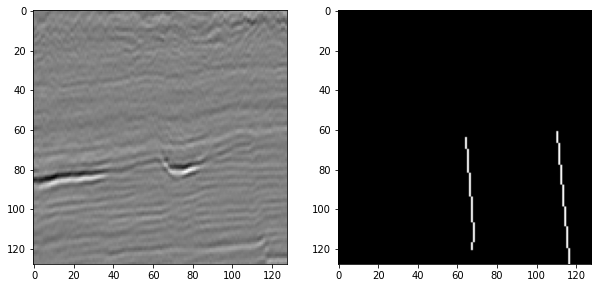

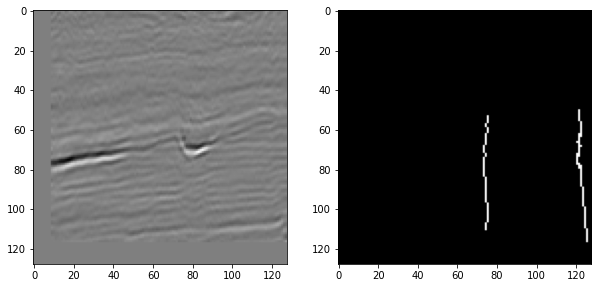

In [ ]:
import matplotlib.pyplot as plt
import imutils


trace = traces[0].copy()
label = labels[0].copy()

aug_tr, aug_lb = AUGS(image=trace[..., None], segmentation_maps=label.astype(np.int32)[None, ...])


aug_tr = aug_tr.squeeze()
aug_lb = aug_lb.squeeze()

fig, axs = plt.subplots(1, 2, figsize=(10, 10))
axs[0].imshow(trace, cmap='gray')
axs[1].imshow(label, cmap='gray')

fig, axs = plt.subplots(1, 2, figsize=(10, 10))
axs[0].imshow(aug_tr, cmap='gray'
)
axs[1].imshow(aug_lb, cmap='gray')

In [ ]:
import wandb
# Download dataset labels from w&b

run = wandb.init(project="faults-segmentation")

WB_CONFIG = wandb.config

wandb: WARNING Calling wandb.login() after wandb.init() has no effect.


epoch,17
loss,0.0224
recall,0.57633
precision,0.29381
dice_coef,0.26003
val_loss,0.02461
val_recall,0.57221
val_precision,0.25467
val_dice_coef,0.23825
lr,0.0005
_step,17


epoch,▁▁▂▂▃▃▃▄▄▅▅▆▆▆▇▇██
loss,█▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
recall,▁▄▅▅▅▆▆▆▆▆▆▇▇▇▇▇██
precision,▁▇▇▇▇▇▇▇▇▇▇█▇█████
dice_coef,▁▄▅▆▆▆▆▇▇▇▇▇▇▇▇███
val_loss,█▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁
val_recall,▂▁▄▅▄▆▇▇▇▅▆▆▅▆▅█▇▇
val_precision,▁█▅▆█▄▄▅▅▆▇▆██▇▅▇▇
val_dice_coef,▁▄▄▆▅▅▅▆▆▆▆▇▇█▇▇██
lr,████████████████▁▁
_step,▁▁▂▂▃▃▃▄▄▅▅▆▆▆▇▇██


In [ ]:
from sklearn.model_selection import train_test_split


train_tr, valid_tr, train_lb, valid_lb = train_test_split(traces, labels, test_size=0.1, random_state=SEED)   

del traces
del labels

TRAIN_SIZE = len(train_tr)
VALID_SIZE = len(valid_tr)

print(f'Train size: {TRAIN_SIZE}')
print(f'Valid size: {VALID_SIZE}')

Train size: 1322
Valid size: 147


In [ ]:

#  target = target.transpose((2, 0, 1))

# plt.figure()
# plt.imshow(target.squeeze(), cmap='gray')

# source = self.scale_min_max(self.traces[i].T)[..., None]

# plt.figure()
# plt.imshow(source.squeeze(), cmap='gray')


# source = source.transpose((2, 0, 1))

# sample = self.remove_high_fr(FDA_source_to_target_np(source, target, L=L).squeeze(), L=0.3)


def perform_augs(trace, label):
    trace = trace.numpy()[..., None]
    label = label.numpy().astype(np.int32)[None, ...]
    trace, label = AUGS(image=trace, segmentation_maps=label)
    return trace.squeeze(), label.squeeze()


def scale_min_max(trace):
    min_v = tf.math.reduce_min(trace)
    max_v = tf.math.reduce_max(trace)
    return (trace - min_v) / (max_v - min_v)

def standardise(trace):
    mean = tf.math.reduce_mean(trace)
    std = tf.math.reduce_std(trace)
    return (trace - mean) / std


@tf.function
def load_train_datapoint(trace, label):

    trace, label = tf.py_function(func=perform_augs, inp=[trace, label], Tout=[tf.float32, tf.float32])

    trace = scale_min_max(trace)

    trace = tf.repeat(trace[:, :, tf.newaxis], 3, axis=2)

    label = label[:, :, tf.newaxis]

    return trace, label




@tf.function
def load_datapoint(trace, label):

    trace = scale_min_max(trace)

    trace = tf.repeat(trace[:, :, tf.newaxis], 3, axis=2)

    label = label[:, :, tf.newaxis]

    return trace, label



WB_CONFIG.BATCH_SIZE = 16
BUFFER_SIZE = TRAIN_SIZE


train_dataset = (tf.data.Dataset.from_tensor_slices(
    (train_tr, train_lb))
    .shuffle(buffer_size=BUFFER_SIZE, seed=SEED, reshuffle_each_iteration=True)
    .map(load_train_datapoint)
    .repeat()
    .batch(WB_CONFIG.BATCH_SIZE)
    .prefetch(buffer_size=AUTOTUNE))



valid_dataset = (tf.data.Dataset.from_tensor_slices(
    (valid_tr, valid_lb))
    .map(load_datapoint)
    .batch(WB_CONFIG.BATCH_SIZE)
    .prefetch(buffer_size=AUTOTUNE))

In [ ]:
for traces, labels in train_dataset.take(1):
    for i, tr, in enumerate(traces):
        fig, axs = plt.subplots(1, 2, figsize=(15, 15))
        tr = tr.numpy()[:,:,0]
        lb = labels[i].numpy().squeeze()

        axs[0].imshow(tr)
        axs[0].imshow(lb, alpha=0.5)
        axs[1].imshow(tr, cmap='gray')

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
for traces, labels in valid_dataset.take(1):
    for i, tr, in enumerate(traces):
        fig, axs = plt.subplots(1, 2, figsize=(15, 15))
        tr = tr.numpy()[:,:,0]
        lb = labels[i].numpy().squeeze()

        axs[0].imshow(tr)
        axs[0].imshow(lb, alpha=0.5)
        axs[1].imshow(tr, cmap='gray')

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
#@title seq dataset loader
from tensorflow.keras.utils import Sequence
import math
import numpy as np
import imutils
from albumentations.augmentations import transforms as T
import albumentations as A
import cv2
from imgaug import augmenters as iaa


class DataGenerator(Sequence):
    def __init__(self, data_x, data_y, batch_size, augs=None):

        self.image_shape = (128, 128, 3)
        self.mask_shape = (128, 128, 1)
        self.data_x = data_x
        self.data_y = data_y
        self.augs = augs
        self.batch_size = batch_size
        self.samples_count = len(self.data_x)
        self.indexes = np.arange(self.samples_count)
        self.on_epoch_end()

    def __len__(self):
        return int(np.floor(self.samples_count / self.batch_size))

    def on_epoch_end(self):
        np.random.shuffle(self.indexes)

    def __getitem__(self, index):

        batch_indexes = self.indexes[index * self.batch_size:(index + 1) * self.batch_size]

        return self.generate_batch(batch_indexes)

        
    def standardize(self, trace):
        mean = trace.mean()
        std = trace.std()
        return (trace - mean) / std

    def scale_min_max(self, trace):
        min_v = trace.min()
        max_v = trace.max()
        return (trace - min_v) / (max_v - min_v)


    def generate_batch(self, batch_indexes):

        batch_x = np.empty((self.batch_size, *self.image_shape))
        batch_y = np.empty((self.batch_size, *self.mask_shape))


        for b_i, i in enumerate(batch_indexes):

            trace = self.data_x[i]
            label = self.data_y[i]

            if self.augs:
                trace = trace[..., None]
                label = label.astype(np.int32)[None, ...]
                aug_tr, aug_lb = self.augs(image=trace, segmentation_maps=label)
                trace = aug_tr.squeeze()
                label = aug_lb.squeeze()

            trace = self.scale_min_max(self.standardize(trace))
                
            batch_x[b_i] = np.repeat(trace[..., None], 3, axis=-1)
            batch_y[b_i] = label[..., None]

        return batch_x, batch_y


WB_CONFIG.BATCH_SIZE = 16
train_dataset = DataGenerator(train_tr, train_lb, augs=AUGS, batch_size=WB_CONFIG.BATCH_SIZE)
valid_dataset  = DataGenerator(valid_tr, valid_lb, batch_size=WB_CONFIG.BATCH_SIZE)

for i in range(1):
    x, y = train_dataset.__getitem__(i)

    for tr, lb in zip(x, y):
        fig, axs = plt.subplots(1, 2, figsize=(15, 15))
        axs[0].imshow(tr[:,:,0])
        axs[0].imshow(lb[:,:,0], alpha=0.5)
        axs[1].imshow(tr[:,:,0], cmap='gray')

In [ ]:
from tensorflow.keras.layers import *
import segmentation_models as sm
from tensorflow.keras import backend as K
from deeplr.estimate import losses
from deeplr.estimate import metrics


sm.set_framework('tf.keras')
K.clear_session()

def bilinear_resize(x, rsize_x, rsize_y):
    return tf.image.resize(x, [rsize_x, rsize_y])


def Conv3x3BnPReLU(x, filters):

    x = Conv2D(filters, kernel_size=(3, 3), strides=1, padding='same', kernel_initializer='he_uniform')(x)
    x = BatchNormalization()(x)
    x = PReLU(shared_axes=[1, 2])(x)

    return x


def decoder_block(x, filters, up_resize_x, up_resize_y, skip=None):

    x = Lambda(lambda r: bilinear_resize(r, up_resize_x, up_resize_y))(x)

    if skip is not None:
        x = concatenate([x, skip], axis = 3)

    x = Conv3x3BnPReLU(x, filters)
    x = Conv3x3BnPReLU(x, filters)

    return x


model = sm.Unet('efficientnetb0', input_shape=(128, 128, 3), classes=2, activation='sigmoid', decoder_block_type='upsampling')
backbone = tf.keras.Model(inputs=model.input, outputs=model.get_layer('block4a_activation').output)

skip_connection_layers = ('block3b_expand_activation', 'block2b_expand_activation', 'block1a_activation')

skips = ([backbone.get_layer(name=i).output for i in skip_connection_layers])


n_upsample_blocks = 4
filters_factor = 4
decoder_filters=(128 * filters_factor, 64 * filters_factor, 32 * filters_factor, 16 * filters_factor)
decoder_resize_x = (16, 32, 64, 128)
decoder_resize_y = (16, 32, 64, 128)

x = backbone.output

for i in range(n_upsample_blocks):
    if i < len(skips):
        skip = skips[i]
    else:
        skip = None

    x = decoder_block(x, decoder_filters[i], decoder_resize_x[i], decoder_resize_y[i], skip)
    

x = Conv2D(
        filters=1,
        kernel_size=(3, 3),
        padding='same',
        use_bias=True,
        activation='sigmoid',
        kernel_initializer='glorot_uniform', name='mask'
    )(x)

model = tf.keras.Model(inputs=backbone.input, outputs=x)


WB_CONFIG.learning_rate = 0.001

# set the same as lr in CLR
optimizer = tf.keras.optimizers.Adam(learning_rate=WB_CONFIG.learning_rate)
STEPS_PER_EPOCH = TRAIN_SIZE // WB_CONFIG.BATCH_SIZE
VALIDATION_STEPS = VALID_SIZE // WB_CONFIG.BATCH_SIZE

def create_weighted_binary_crossentropy(zero_weight, one_weight):

    def weighted_binary_crossentropy_custom(y_true, y_pred):
        b_ce = K.binary_crossentropy(y_true, y_pred)
        weight_vector = y_true * one_weight + (1. - y_true) * zero_weight
        weighted_b_ce = weight_vector * b_ce
        return K.mean(weighted_b_ce)

    return weighted_binary_crossentropy_custom

def dice_loss(y_true, y_pred):
    smooth = 1.
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = y_true_f * y_pred_f
    score = (2. * K.sum(intersection) + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)
    return 1. - score

recall = tf.metrics.Recall(name="recall")
precision = tf.metrics.Precision(name="precision")


loss = dice_loss
# loss = create_weighted_binary_crossentropy(0.2, 1)
metrics = [recall, precision, metrics.dice_coef]

model.compile(optimizer=optimizer, loss=loss, metrics=metrics)
model.summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 128, 128, 3) 0                                            
__________________________________________________________________________________________________
stem_conv (Conv2D)              (None, 64, 64, 32)   864         input_1[0][0]                    
__________________________________________________________________________________________________
stem_bn (BatchNormalization)    (None, 64, 64, 32)   128         stem_conv[0][0]                  
__________________________________________________________________________________________________
stem_activation (Activation)    (None, 64, 64, 32)   0           stem_bn[0][0]                    
____________________________________________________________________________________________

In [ ]:

from tensorflow.keras.callbacks import TensorBoard, ModelCheckpoint, Callback, ReduceLROnPlateau
from tensorflow.keras.callbacks import LearningRateScheduler
from wandb.keras import WandbCallback



WB_CONFIG.patience = 3
WB_CONFIG.epochs = 30

CHECKPOINT = '/content/drive/My Drive/Faults/3D_2DSynt_Segmentation/models/2d/base_model.h5' # your path

# Save checkpoints
checkpoint = ModelCheckpoint(CHECKPOINT, monitor='val_loss', verbose=1, save_weights_only=False , save_best_only=True, mode='min')

# Callbacks 
reduce_lr = ReduceLROnPlateau(factor=0.5, patience=WB_CONFIG.patience, min_lr=0.000001, verbose=1)


callbacks_list = [checkpoint, reduce_lr, WandbCallback()]


model_history = model.fit(train_dataset, epochs=WB_CONFIG.epochs,
                          steps_per_epoch=STEPS_PER_EPOCH,
                          validation_steps=VALIDATION_STEPS,
                          validation_data=valid_dataset,
                          callbacks=callbacks_list)

Epoch 1/30
82/82 [==============================] - ETA: 0s - loss: 0.7529 - recall: 0.4382 - precision: 0.1246 - dice_coef: 0.2471
Epoch 00001: val_loss improved from inf to 0.90372, saving model to /content/drive/My Drive/Faults/3D_2DSynt_Segmentation/models/2d/base_model.h5
82/82 [==============================] - 164s 2s/step - loss: 0.7529 - recall: 0.4382 - precision: 0.1246 - dice_coef: 0.2471 - val_loss: 0.9037 - val_recall: 0.2127 - val_precision: 0.1517 - val_dice_coef: 0.0963 - lr: 0.0010
Epoch 2/30
82/82 [==============================] - ETA: 0s - loss: 0.6863 - recall: 0.4029 - precision: 0.2611 - dice_coef: 0.3137
Epoch 00002: val_loss improved from 0.90372 to 0.76302, saving model to /content/drive/My Drive/Faults/3D_2DSynt_Segmentation/models/2d/base_model.h5
82/82 [==============================] - 164s 2s/step - loss: 0.6863 - recall: 0.4029 - precision: 0.2611 - dice_coef: 0.3137 - val_loss: 0.7630 - val_recall: 0.4213 - val_precision: 0.1687 - val_dice_coef: 0.2370

KeyboardInterrupt: ignored

In [ ]:
model = tf.keras.models.load_model(CHECKPOINT,
                                   custom_objects={'recall': tf.metrics.Recall(name="recall"),
                                                   'precision': tf.metrics.Precision(name="precision"),
                                                    'loss': losses.dice_coef_loss, 
                                                   })
# metrics.dice_coef
model.summary()

(1469, 128, 128)

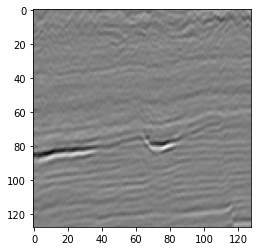

In [ ]:
#@title load 128 test patches
import pickle
from matplotlib import pyplot as plt

def get_samples_hand_crop(path):
    with open(path, 'rb') as handle:
        data_set = pickle.load(handle)  
    return data_set['X_set'], data_set['y_set']


def standardizer(tr):
    ''' Standardize amplitudes within the image '''
    std_func = lambda x: (x - np.mean(x)) / np.std(x)
    tr_std = std_func(tr)
    return tr_std


def scale_min_max(x):
    x = (x - x.min()) / (x.max() - x.min())
    return x    

DATA_PATH = '/content/drive/My Drive/Faults/data/Lapteva_faults128x128(1469).pickle'

test_traces, test_labels = get_samples_hand_crop(DATA_PATH)

plt.imshow(test_traces[0], cmap='gray')

test_traces.shape

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if __name__ == '__main__':


KeyboardInterrupt: ignored

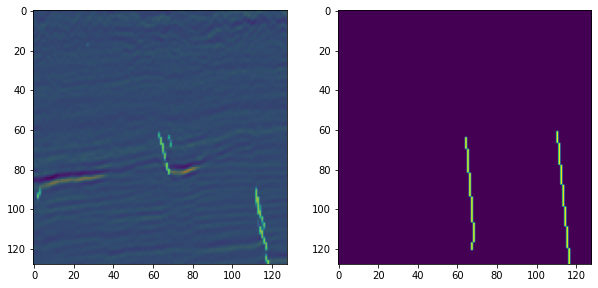

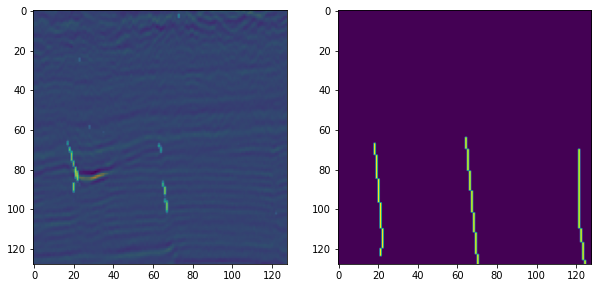

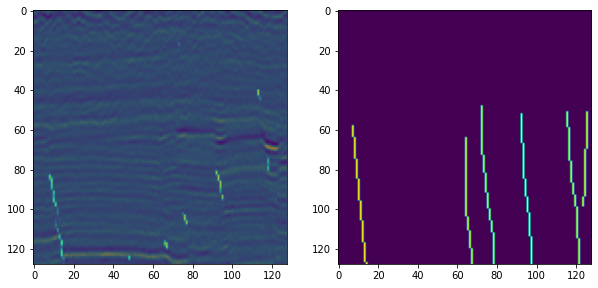

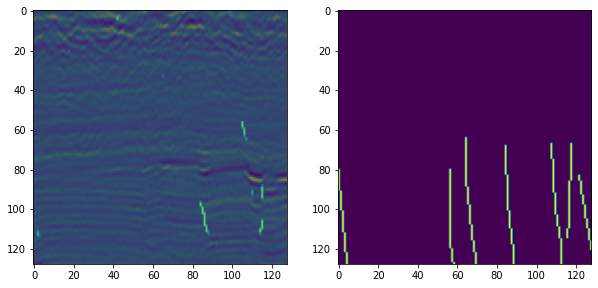

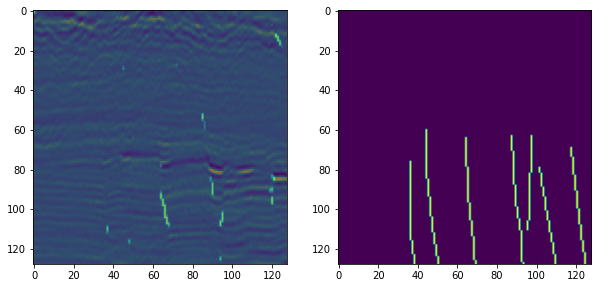

...

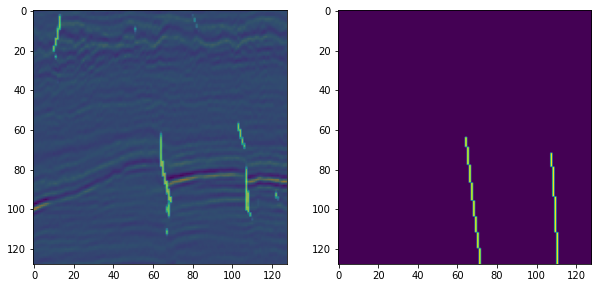

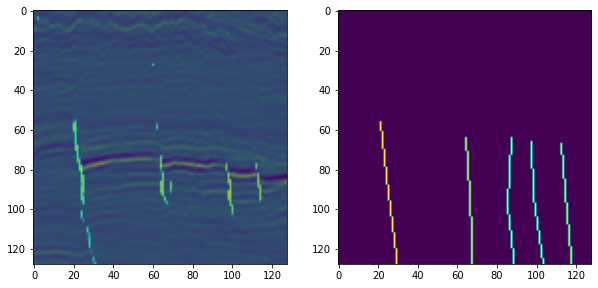

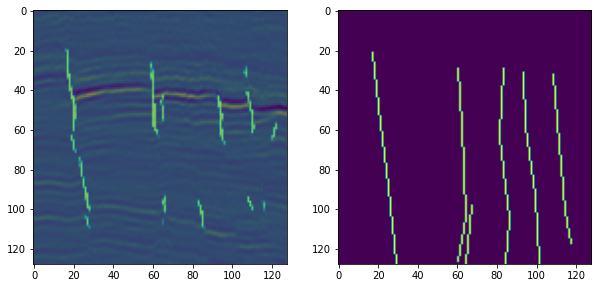

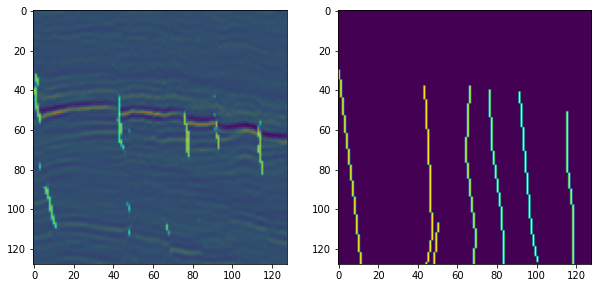

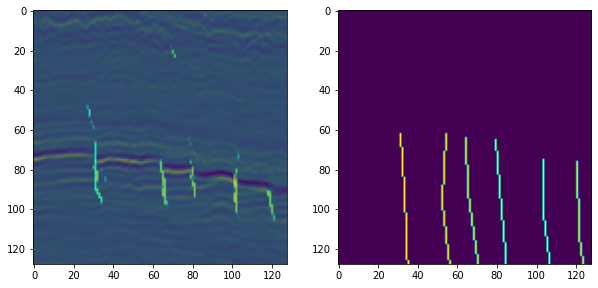

<Figure size 720x720 with 0 Axes>

In [ ]:

for tr, lb in zip(test_traces, test_labels):

    tr = standardizer(scale_min_max(tr))

    pred = model.predict(np.repeat(tr[None, ..., None], 3, axis=-1))


    fig, axs = plt.subplots(1, 2, figsize=(10, 10))
    axs[0].imshow(tr)
    axs[0].imshow(pred.squeeze(), alpha=0.5)
    axs[1].imshow(lb)

# Test model

In [ ]:
!pip install segyio
!pip install obspy

     |████████████████████████████████| 92kB 5.2MB/s 
     |████████████████████████████████| 24.7MB 34.4MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
    Preparing wheel metadata ... done
  Created wheel for obspy: filename=obspy-1.2.2-cp36-cp36m-linux_x86_64.whl size=21667305 sha256=8fbc4134a59703b4a1c18686eb7a30ca0d8126c765e7babce3e69be6712a5c43
  Stored in directory: /root/.cache/pip/wheels/94/e0/86/44fd4cea7661f42431c8f6d030f2758ff275cccffcbe8fa2b8
Successfully built obspy


In [ ]:
from obspy.io.segy.core import _read_segy as read_segy
from obspy.io.segy.segy import _read_segy
import numpy as np
image_sgy_stream = read_segy('/content/drive/My Drive/Faults/preprocess/sgyprocess/F3_entire.sgy')
image_sgy = np.stack(t.data for t in image_sgy_stream.traces)

/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2822: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  if self.run_code(code, result):


In [ ]:
data_sgy = np.zeros((651 * 951, 462))
data_sgy.shape

(619101, 462)

In [ ]:
extend_count = data_sgy.shape[0] - image_sgy.shape[0]
extend_count

18586

In [ ]:
data_sgy[:image_sgy.shape[0], :] = image_sgy

In [ ]:
data_sgy = np.array(data_sgy).reshape(651, 951, 462)
data_sgy_reshaped = data_sgy
data_sgy.shape

(651, 951, 462)

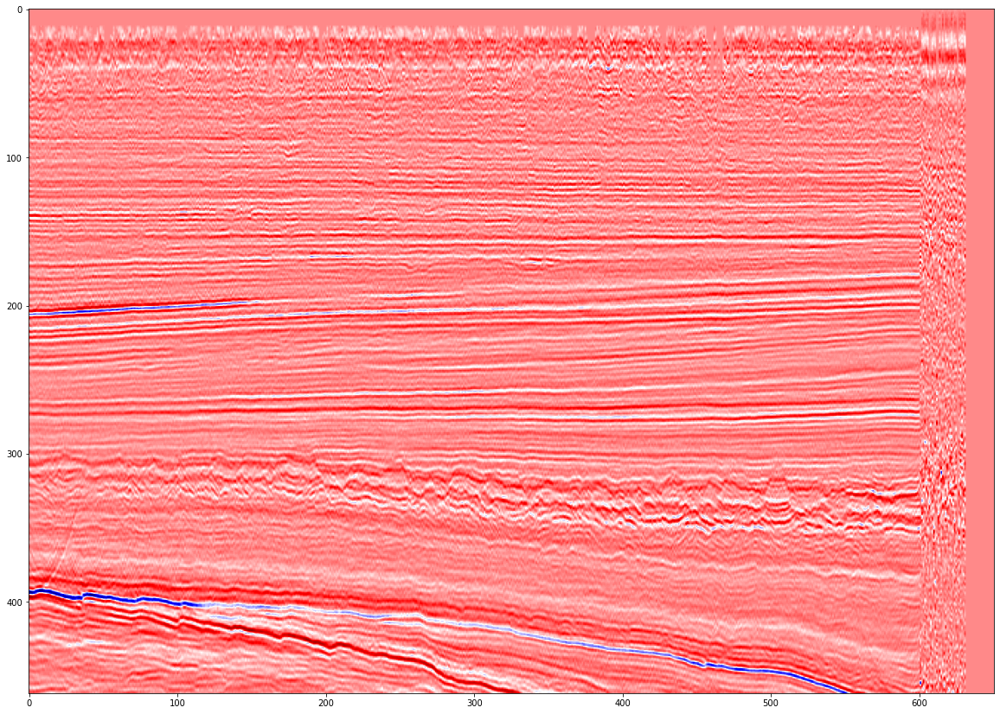

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20, 20))
plt.imshow(data_sgy[:, 20, :].T, cmap='seismic')

In [ ]:
#@title slice viewer
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.widgets import Slider
from ipywidgets.widgets import *
from ipywidgets import widgets
from IPython.display import display

plt.style.use('seaborn-white')



class SliceViewer():

    '''
        Arguments: 
            traces_volume - np.array with shape (nx, ny, nz)
            labels_volume - np.array with shape (nx, ny, nz)
            figsize - tuple, plot size

    '''

    def __init__(self, traces_volume, labels_volume,
                 figsize=(7, 7), tr_cmap='gray', lb_cmap='Greens'):

        assert traces_volume.shape == labels_volume.shape, 'Shapes must be equal'

        self.tr_volume = traces_volume
        self.lb_volume = labels_volume
        self.figsize = figsize
        self.tr_cmap = tr_cmap
        self.lb_cmap = lb_cmap

        self.nx, self.ny, self.nz = self.tr_volume.shape

        self.widget = self.__create_widget()


    def __create_widget(self):

        x_slider = IntSlider(min=0, max=self.nx - 1, step=1, value=int(self.nx/2))
        y_slider = IntSlider(min=0, max=self.ny - 1, step=1, value=int(self.ny/2))
        z_slider = IntSlider(min=0, max=self.nz - 1, step=1, value=int(self.nz/2))
        alpha = IntSlider(min=0, max=100, step=5, value=70)
        selector = ['x','y','z']
        w = interact(self.__show, x=x_slider, y=y_slider,
                     z=z_slider, alpha=alpha, dim=selector)

        return w

    
    def __get_slice(self, x, y, z, dim):

        if dim == 'x':
            tr = self.tr_volume[x, :, :]
            lb = self.lb_volume[x, :, :]
        elif dim == 'y':
            tr = self.tr_volume[:, y, :]
            lb = self.lb_volume[:, y, :]
        else:
            tr = self.tr_volume[:, :, z]
            lb = self.lb_volume[:, :, z]
        
        return tr, lb


    def __set_labels(self, ax, dim):

        if dim == 'x':
            ax.set_xlabel('y')
            ax.set_ylabel('z')
        elif dim == 'y':
            ax.set_xlabel('x')
            ax.set_ylabel('z')
        else:
            ax.set_xlabel('y')
            ax.set_ylabel('x')

    
    def __show(self, x, y, z, alpha, dim):

        tr, lb = self.__get_slice(x, y, z, dim)

        fig, ax = plt.subplots(figsize=self.figsize)
        plt.imshow(tr.T, cmap=self.tr_cmap, aspect='equal')
        plt.imshow(lb.T, alpha=(100-alpha)/100, aspect='equal', cmap=self.lb_cmap)
        self.__set_labels(ax, dim)
        plt.grid()
        plt.show()
        display()

        ax.set_xlabel('x')
        ax.set_ylabel('z')


In [ ]:
SliceViewer(data_sgy, data_sgy, figsize=(12, 12), tr_cmap='seismic', lb_cmap='seismic')

interactive(children=(IntSlider(value=325, description='x', max=650), IntSlider(value=475, description='y', ma…

In [ ]:
def scale_img(x):
    x = (x - x.min()) / (x.max() - x.min())
    return x

def stand(x):
    x = (x - x.mean()) / x.std()
    return x

start_i = 200

sub_volume = data_sgy[:128, start_i:start_i + 128 ,334:462]

sub_volume = stand(scale_img(sub_volume))
sub_volume.shape

(128, 128, 128)

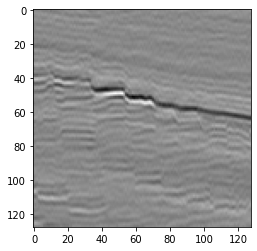

In [ ]:
plt.imshow(sub_volume[50].T, cmap='gray')

In [ ]:
np.repeat(sub_volume[50].T[None, ..., None], 3, axis=-1).shape

(1, 128, 128, 3)

In [ ]:
pr = model.predict(np.repeat(sub_volume[50].T[None, ..., None], 3, axis=-1))
pr = pr.squeeze()
pr.shape

(128, 128)

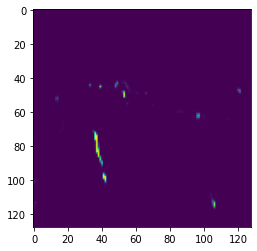

In [ ]:
plt.imshow(pr, alpha=0.5)

In [ ]:
#@title slice viewer
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.widgets import Slider
from ipywidgets.widgets import *
from ipywidgets import widgets
from IPython.display import display

plt.style.use('seaborn-white')



class SliceViewer():

    '''
        Arguments: 
            traces_volume - np.array with shape (nx, ny, nz)
            labels_volume - np.array with shape (nx, ny, nz)
            figsize - tuple, plot size

    '''

    def __init__(self, traces_volume, labels_volume,
                 figsize=(7, 7), tr_cmap='gray', lb_cmap='Greens'):

        assert traces_volume.shape == labels_volume.shape, 'Shapes must be equal'

        self.tr_volume = traces_volume
        self.lb_volume = labels_volume
        self.figsize = figsize
        self.tr_cmap = tr_cmap
        self.lb_cmap = lb_cmap

        self.nx, self.ny, self.nz = self.tr_volume.shape

        self.widget = self.__create_widget()


    def __create_widget(self):

        x_slider = IntSlider(min=0, max=self.nx - 1, step=1, value=int(self.nx/2))
        y_slider = IntSlider(min=0, max=self.ny - 1, step=1, value=int(self.ny/2))
        z_slider = IntSlider(min=0, max=self.nz - 1, step=1, value=int(self.nz/2))
        alpha = IntSlider(min=0, max=100, step=5, value=70)
        selector = ['x','y','z']
        w = interact(self.__show, x=x_slider, y=y_slider,
                     z=z_slider, alpha=alpha, dim=selector)

        return w

    
    def __get_slice(self, x, y, z, dim):

        if dim == 'x':
            tr = self.tr_volume[x, :, :]
            lb = self.lb_volume[x, :, :]
        elif dim == 'y':
            tr = self.tr_volume[:, y, :]
            lb = self.lb_volume[:, y, :]
        else:
            tr = self.tr_volume[:, :, z]
            lb = self.lb_volume[:, :, z]
        
        return tr, lb


    def __set_labels(self, ax, dim):

        if dim == 'x':
            ax.set_xlabel('y')
            ax.set_ylabel('z')
        elif dim == 'y':
            ax.set_xlabel('x')
            ax.set_ylabel('z')
        else:
            ax.set_xlabel('y')
            ax.set_ylabel('x')

    
    def __show(self, x, y, z, alpha, dim):

        tr, lb = self.__get_slice(x, y, z, dim)

        fig, ax = plt.subplots(figsize=self.figsize)
        plt.imshow(tr.T, cmap=self.tr_cmap, aspect='equal')
        plt.imshow(lb.T, alpha=(100-alpha)/100, aspect='equal', cmap=self.lb_cmap)
        self.__set_labels(ax, dim)
        plt.grid()
        plt.show()
        display()

        ax.set_xlabel('x')
        ax.set_ylabel('z')


In [ ]:
m = pr > 0.8
pr[m] = 1
pr[~m] = 0

In [ ]:
SliceViewer(sub_volume, pr, figsize=(12, 12))

interactive(children=(IntSlider(value=64, description='x', max=127), IntSlider(value=64, description='y', max=…

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


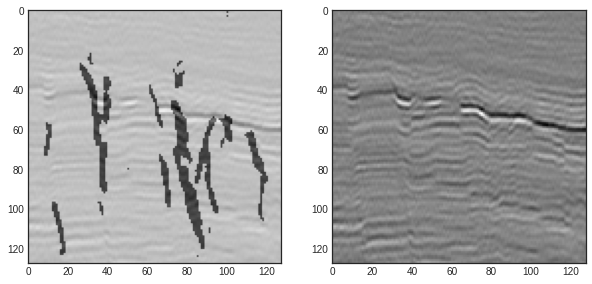

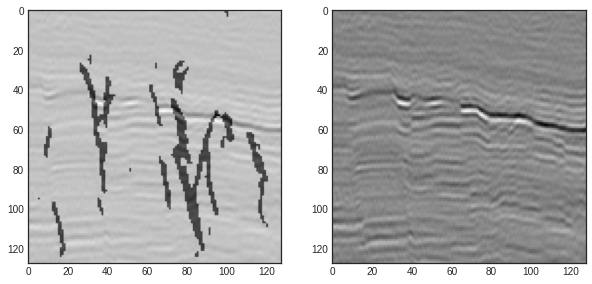

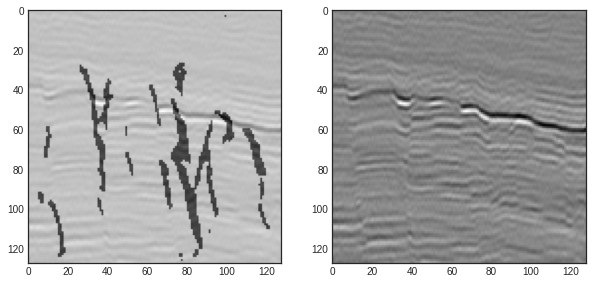

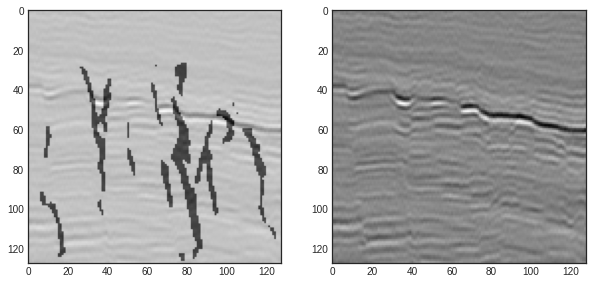

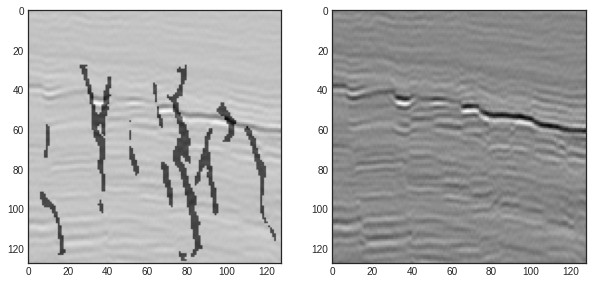

...

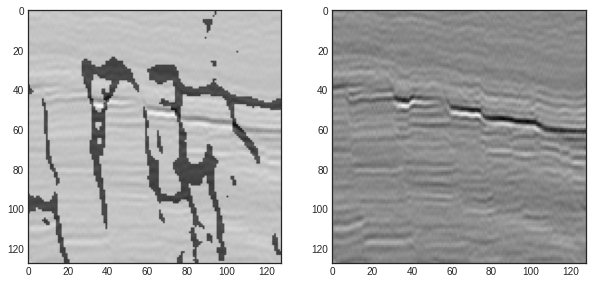

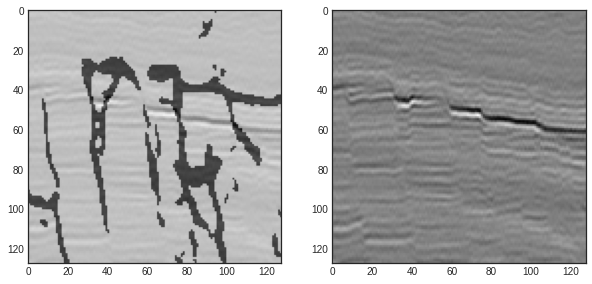

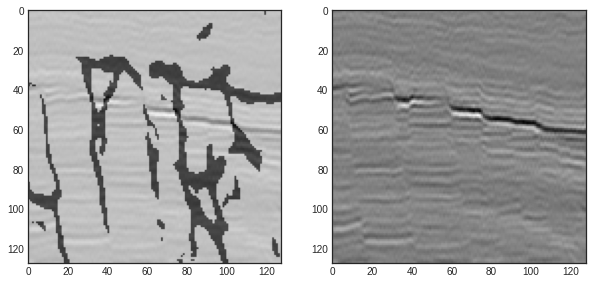

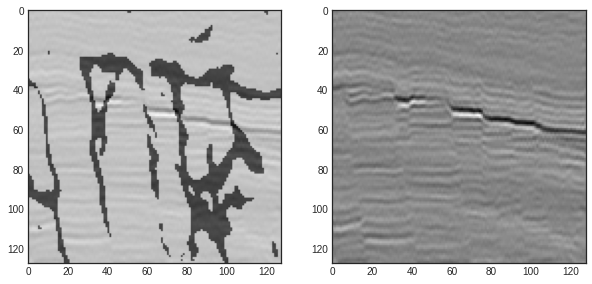

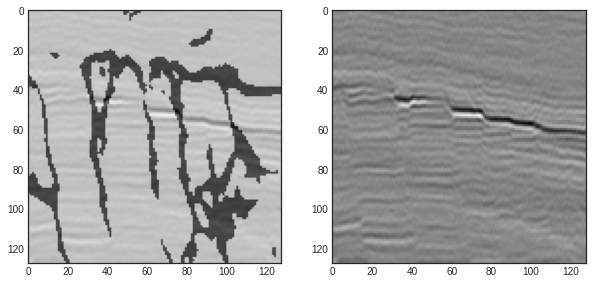

In [ ]:
for i in range(128):

    fig, axs = plt.subplots(1, 2, figsize=(10, 10))

    s = sub_volume[i].T
    lb = pr[i].T
    m = lb > 0.5
    lb[m] = 1
    lb[~m] = 0

    axs[0].imshow(s, cmap='gray')
    axs[0].imshow(lb, alpha=0.5)
    axs[1].imshow(s, cmap='gray')

    if i == 20:
        break